# SSD, ONNX Model, Visualization, Inferencing

This notebook explores the process of inferencing using the SSD ONNX model with the ONNX Runtime Server. It includes training a pre-trained PyTorch SSD model, converting it to ONNX, and deploying it for inferencing.

## Overview
The key steps involve testing the pre-trained model, fine-tuning it for new categories, converting the model to ONNX, and running inferencing using the ONNX Runtime.

## Procedure
- **Pre-trained Model Testing**: Test the pre-trained PyTorch MobilenetV1 SSD model on the Pascal VOC 2007 dataset.
- **Model Fine-tuning**: Fine-tune the pre-trained model on selected categories from the Google Open Images dataset.
- **Model Conversion**: Export the fine-tuned model to ONNX format and verify its structure.
- **Inferencing with ONNX Runtime**: Create an inference session, run the model, and compare outputs with PyTorch.
- **Inferencing Setup Test**: Test the inferencing setup using sample images from the selected categories.
- **[BONUS] Output Visualization**: Parse the ORT response and annotate the images with bounding boxes and labels.

References:
- [PyTorch SSD Implementation](https://github.com/qfgaohao/pytorch-ssd)
- [PyTorch to ONNX Tutorial](https://pytorch.org​⬤

In [1]:
import warnings 
warnings.filterwarnings("ignore")

In [3]:
import numpy as np
import pandas as pd

pd.__version__, np.__version__

('2.0.0', '1.22.0')

In [6]:
# !mamba install pytorch torchvision torchaudio pytorch-cuda=12.1 -c pytorch -c nvidia


                  __    __    __    __
                 /  \  /  \  /  \  /  \
                /    \/    \/    \/    \
███████████████/  /██/  /██/  /██/  /████████████████████████
              /  / \   / \   / \   / \  \____
             /  /   \_/   \_/   \_/   \    o \__,
            / _/                       \_____/  `
            |/
        ███╗   ███╗ █████╗ ███╗   ███╗██████╗  █████╗
        ████╗ ████║██╔══██╗████╗ ████║██╔══██╗██╔══██╗
        ██╔████╔██║███████║██╔████╔██║██████╔╝███████║
        ██║╚██╔╝██║██╔══██║██║╚██╔╝██║██╔══██╗██╔══██║
        ██║ ╚═╝ ██║██║  ██║██║ ╚═╝ ██║██████╔╝██║  ██║
        ╚═╝     ╚═╝╚═╝  ╚═╝╚═╝     ╚═╝╚═════╝ ╚═╝  ╚═╝

        mamba (1.1.0) supported by @QuantStack

        GitHub:  https://github.com/mamba-org/mamba
        Twitter: https://twitter.com/QuantStack

█████████████████████████████████████████████████████████████


Looking for: ['pytorch', 'torchvision', 'torchaudio', 'pytorch-cuda=12.1']

conda-forge/linux-64                 

In [3]:
import torch
import torchvision.models as models
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision as vision 
import os 

In [4]:

# Download pre-trained MobileNetV1 SSD model
device = 'cuda' if torch.cuda.is_available() else ('mps' if torch.backend.mps.is_available() else 'cpu')
model_path = "models/mobilenet-v1-ssd-mp-0_675.pth" if 'pytorch-ssd' in os.getcwd() else 'pytorch-ssd/models/mobilenet-v1-ssd-mp-0_675.pth'
# model = torch.load(model_path, map_location=torch.device(device), weights_only=True)

# Download Pascal VOC 2007 dataset
dataset = datasets.VOCDetection(root='./data', year='2007', image_set='test', download=True)




Using downloaded and verified file: ./data/VOCtest_06-Nov-2007.tar
Extracting ./data/VOCtest_06-Nov-2007.tar to ./data


KeyboardInterrupt: 

In [6]:
!python eval_ssd.py --net mb1-ssd  a!python eval_ssd.py --net mb1-ssd  --dataset ./data/VOCdevkit/VOC2007 --trained_model ./models/mobilenet-v1-ssd-mp-0_675.pth --label_file ./models/voc-model-labels.txt-dataset ./data/VOCdevkit/VOC2007 --trained_model ./models/pytorch-ssd-models/mobilenet-v1-ssd-mp-0_675.pth --label_file ./models/voc-model-labels.txt

python: can't open file '/scratch/dan9232/ADS/homework06/p6/eval_ssd.py': [Errno 2] No such file or directory


In [12]:
print(f"{round(0.68432 * 100, 2)}%")
print(f"{round(0.79111 * 100, 2)}%")
print(f"{round(0.61718 * 100, 2)}%")
print(f"{round(0.56122 * 100, 2)}%")
print(f"{round(0.34852 * 100, 2)}%")
print(f"{round(0.76778 * 100, 2)}%")
print(f"{round(0.72809 * 100, 2)}%")
print(f"{round(0.83692 * 100, 2)}%")
print(f"{round(0.51691 * 100, 2)}%")
print(f"{round(0.62386 * 100, 2)}%")
print(f"{round(0.70621 * 100, 2)}%")
print(f"{round(0.78728 * 100, 2)}%")
print(f"{round(0.8194 * 100, 2)}%")
print(f"{round(0.79185 * 100, 2)}%")
print(f"{round(0.7023 * 100, 2)}%")
print(f"{round(0.398529 * 100, 2)}%")
print(f"{round(0.60666 * 100, 2)}%")
print(f"{round(0.75730 * 100, 2)}%")
print(f"{round(0.82624 * 100, 2)}%")
print(f"{round(0.64618 * 100, 2)}%")
print(f"{round(0.67590 * 100, 2)}%")

68.43%
79.11%
61.72%
56.12%
34.85%
76.78%
72.81%
83.69%
51.69%
62.39%
70.62%
78.73%
81.94%
79.19%
70.23%
39.85%
60.67%
75.73%
82.62%
64.62%
67.59%


### Average Precision Per-class:
| Class           | Average Precision |
|-----------------|------------------:|
| aeroplane       |            68.43% |
| bicycle         |            79.11% |
| bird            |            61.72% |
| boat            |            56.12% |
| bottle          |            34.85% |
| bus             |            76.78% |
| car             |            72.81% |
| cat             |            83.69% |
| chair           |            51.69% |
| cow             |            62.39% |
| diningtable     |            70.62% |
| dog             |            78.73% |
| horse           |            81.94% |
| motorbike       |            79.19% |
| person          |            70.23% |
| pottedplant     |            39.85% |
| sheep             |            60.67% |
| sofa            |            75.73% |
| train           |            82.62% |
| tvmonitor       |            64.62% |
| **Average Precision Across All Classes** | **67.59%** |

In [22]:
import torch
import torchvision.models as models
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision as vision 

# Download pre-trained MobileNetV1 SSD model
import torch

model_path = "/Users/darien/Library/Mobile Documents/com~apple~CloudDocs/05NYU/ADS/homework/homework06/p5/pytorch-ssd/models/mobilenet-v1-ssd-mp-0_675.pth"
model_net = torch.load(model_path, map_location=torch.device('mps'), weights_only=True)

# Download Pascal VOC 2007 dataset
dataset = datasets.VOCDetection(root='./data', year='2007', image_set='test', download=True)




Using downloaded and verified file: ./data/VOCtest_06-Nov-2007.tar
Extracting ./data/VOCtest_06-Nov-2007.tar to ./data


# 6.2

Selected Open Data Classes 2:
- Piano
- Saxophone

In [3]:
%cd pytorch-ssd

/scratch/dan9232/ADS/homework06/p6/pytorch-ssd


In [9]:
%pip install boto3

  Using cached jmespath-1.0.1-py3-none-any.whl.metadata (7.6 kB)
  Using cached s3transfer-0.10.1-py3-none-any.whl.metadata (1.7 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.9/48.9 kB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.2/12.2 MB 52.7 MB/s eta 0:00:00:00:010:01
Using cached jmespath-1.0.1-py3-none-any.whl (20 kB)
Using cached s3transfer-0.10.1-py3-none-any.whl (82 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.8/143.8 kB 12.1 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [7]:
pwd

'/scratch/dan9232/ADS/homework06/p6/pytorch-ssd'

In [5]:
!python open_images_downloader.py --root ./data/open_images --class_names "Alarm clock,Digital clock" --num_workers 20

2024-04-30 02:17:43,547 - root - Read annotation file ./data/open_images/train-annotations-bbox.csv


In [5]:
# !python train_ssd.py \
#     --dataset_type open_images \
#     --datasets data/open_images \
#     --net mb1-ssd \
#     --pretrained_ssd models/mobilenet-v1-ssd-mp-0_675.pth \
#     --scheduler cosine \
#     --lr 0.01 \
#     --t_max 100 \
#     --validation_epochs 5 \
#     --num_epochs 100 \
#     --base_net_lr 0.001  \
#     --batch_size 64


!python train_ssd.py \
    --dataset_type open_images \
    --datasets data/open_images \
    --net mb1-ssd \
    --pretrained_ssd models/mobilenet-v1-ssd-mp-0_675.pth \
    --scheduler cosine \
    --lr 0.01 \
    --t_max 100 \
    --validation_epochs 5 \
    --num_epochs 10 \
    --base_net_lr 0.001  \
    --batch_size 32 \
    --num_workers 10 \
    --checkpoint_folder run_gpu
    # --use_cuda True \
    # --resume training/mb1-ssd-Epoch-99-Loss-2.196930408477783.pth

2024-04-30 02:31:42,493 - root - INFO - Use Cuda.
2024-04-30 02:31:42,493 - root - INFO - Namespace(dataset_type='open_images', datasets=['data/open_images'], validation_dataset=None, balance_data=False, net='mb1-ssd', freeze_base_net=False, freeze_net=False, mb2_width_mult=1.0, lr=0.01, momentum=0.9, weight_decay=0.0005, gamma=0.1, base_net_lr=0.001, extra_layers_lr=None, base_net=None, pretrained_ssd='models/mobilenet-v1-ssd-mp-0_675.pth', resume=None, scheduler='cosine', milestones='80,100', t_max=100.0, batch_size=32, num_epochs=10, num_workers=10, validation_epochs=5, debug_steps=100, use_cuda=True, checkpoint_folder='run_gpu')
2024-04-30 02:31:42,494 - root - INFO - Prepare training datasets.
2024-04-30 02:31:42,636 - root - INFO - Dataset Summary:Number of Images: 296
Minimum Number of Images for a Class: -1
Label Distribution:
	Alarm clock: 169
	Digital clock: 199
2024-04-30 02:31:42,637 - root - INFO - Stored labels into file run_gpu/open-images-model-labels.txt.
2024-04-30 02

# 5.3

3. Export the Pytorch model to ONNX using torch.onnx.export() function and save it. When you export the model the function will execute the model, recording a trace of what operators are used to compute the outputs. Because export runs the model, we need to provide an input tensor x. The values in this can be random as long as it is the type and size. Use a dummy random tensor. (3) 


In [17]:
%cd pytorch-ssd/

[Errno 2] No such file or directory: 'pytorch-ssd/'
/scratch/dan9232/ADS/homework06/p6/pytorch-ssd


In [3]:

# Export the model to ONNX
output_path = 'output/mb1-ssd-1.onnx'
torch.onnx.export(model_net, 
                dummy_input, 
                output_path,
                  input_names=['input'],
                  output_names=['output'],
)  # Adjust the opset version if needed


# 5.4
4. Load the saved model using onnx.load and verify the model's structure using onnx.checker.check model. (3) 



In [5]:
import onnx
output_path = 'output/mb1-ssd.onnx'
# output_path = 'scratch'
model_path_onnx = output_path


onnx_model = onnx.load(model_path_onnx)
onnx.checker.check_model(onnx_model)
print("shes good!")

shes good!


5. Next run the model with ONNX Runtime (ORT). You first need to create an inference session for the model and then evaluate the model using the run() API. (3) 



In [8]:
import onnxruntime 

ort_session = onnxruntime.InferenceSession(model_path_onnx)

def to_numpy(tensor):
    return tensor.detach().cpu().numpy() if tensor.requires_grad else tensor.cpu().numpy()

# ONNX Runtime output prediction
ort_inputs = {ort_session.get_inputs()[0].name: to_numpy(dummy_input)}
ort_outs = ort_session.run(None, ort_inputs)

ort_outs[0].shape, ort_outs[1].shape

: 

In [ ]:
import onnxruntime 
import numpy as np 

try:
    providers = [("CUDAExecutionProvider", {"device_id": torch.cuda.current_device(),
                                            "user_compute_stream": str(torch.cuda.current_stream().cuda_stream)})]
    sess_options = onnxruntime.SessionOptions()
    ort_session = onnxruntime.InferenceSession(model_path, sess_options=sess_options, providers=providers)
    ort_inputs = {ort_session.get_inputs()[0].name: dummy_input.detach().numpy()}
    ort_outs = ort_session.run(None, ort_inputs)
except:
    ort_inputs = {ort_session.get_inputs()[0].name: dummy_input.detach().cpu().numpy()}
    ort_outs = ort_session.run(None, ort_inputs)

try:
    if isinstance(torch_out, tuple):
        for i in range(len(torch_out)):
            np.testing.assert_allclose(torch_out[i].detach().numpy(), ort_outs[i], rtol=1e-03, atol=1e-05)
    else:
        np.testing.assert_allclose(torch_out.detach().numpy(), ort_outs[0], rtol=1e-03, atol=1e-05)
except:
    if isinstance(torch_out, tuple):
        for i in range(len(torch_out)):
            np.testing.assert_allclose(torch_out[i].detach().cpu().numpy(), ort_outs[i], rtol=1e-03, atol=1e-05)
    else:
        np.testing.assert_allclose(torch_out.detach().cpu().numpy(), ort_outs[0], rtol=1e-03, atol=1e-05)

print("Exported model has been tested with ONNXRuntime, and the result looks good!")


Exported model has been tested with ONNXRuntime, and the result looks good!


In [84]:
ort_outs[0].shape, ort_outs[1].shape

((15, 3000, 3), (15, 3000, 4))

# 5.6
6. Does the output of PyTorch (from torch.out) and ONNX Runtime match? What precision did you use to match? (2) 



In [5]:
## torch model output
def to_numpy(tensor):
    try:
        out = tensor.detach().cpu().numpy()
    except:
        out = tensor.cpu().numpy()
    return out


torch_out = model_net(dummy_input)
torch_out_array = torch_out[0] 
torch_out_array.shape
torch_out_array = [to_numpy(o) for o in torch_out]

torch_out_array[0]

array([[[0.965161  , 0.01231981, 0.02251915],
        [0.98422563, 0.00712124, 0.00865311],
        [0.95746297, 0.01475622, 0.02778081],
        ...,
        [0.3280884 , 0.04092676, 0.6309848 ],
        [0.47274518, 0.05613743, 0.47111744],
        [0.49372795, 0.03016445, 0.4761076 ]],

       [[0.9620706 , 0.01499463, 0.02293479],
        [0.98407286, 0.00832255, 0.0076046 ],
        [0.9573432 , 0.01552814, 0.02712863],
        ...,
        [0.33692157, 0.04088576, 0.6221927 ],
        [0.4821809 , 0.05503342, 0.46278575],
        [0.49058834, 0.02992121, 0.47949043]],

       [[0.9627294 , 0.01336444, 0.02390615],
        [0.9820823 , 0.00832399, 0.00959374],
        [0.9540814 , 0.01454809, 0.03137051],
        ...,
        [0.36058882, 0.04310636, 0.59630483],
        [0.4971817 , 0.06098049, 0.44183776],
        [0.5366125 , 0.03193838, 0.43144915]],

       ...,

       [[0.9693823 , 0.01175688, 0.01886082],
        [0.98593116, 0.00700608, 0.00706277],
        [0.9585494 , 0

In [ ]:
torch_out = model_net(dummy_input)
torch_out_array = [to_numpy(o) for o in torch_out]

np.testing.assert_allclose(torch_out_array[0], ort_outs[0], rtol=1e-03, atol=1e-05)
np.testing.assert_allclose(torch_out_array[1], ort_outs[1], rtol=1e-03, atol=1e-05)
print("Check")


Check


**Answer:**
- `rtol=1e-03` and `atol=1e-05` are used to define the tolerance levels when comparing the outputs of the PyTorch model and the ONNX Runtime.

- An `rtol=1e-03` signifies that the relative difference between the outputs must be less than 0.001 for all elements.

- On the other hand, an `atol=1e-05` signifies that the absolute difference between the outputs must be less than 0.00001 for all elements.

Since no error was raised during the comparison we can conclude that the outputs from the PyTorch model and ONNX Runtime match within the specified tolerance levels.


In [1]:
%cd pytorch-ssd/

/scratch/dan9232/ADS/homework06/p6/pytorch-ssd


7. Test the inferencing set-up using 1 image from each of the two selected categories. For this, you will need to load the images, preprocess them, and then do inference using the run() API from ORT. (5) 


In [4]:
!python eval_ssd.py --net mb1-ssd  --dataset data/open_data/test --trained_model training/mb1-ssd-Epoch-99-Loss-2.196930408477783.pth --label_file models/voc-model-labels.txt

Traceback (most recent call last):
  File "/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/eval_ssd.py", line 131, in <module>
    dataset = VOCDataset(args.dataset, is_test=True)
  File "/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/vision/datasets/voc_dataset.py", line 24, in __init__
    self.ids = VOCDataset._read_image_ids(image_sets_file)
  File "/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/vision/datasets/voc_dataset.py", line 87, in _read_image_ids
    with open(image_sets_file) as f:
FileNotFoundError: [Errno 2] No such file or directory: 'data/open_data/test/ImageSets/Main/test.txt'


In [3]:
!python eval_ssd.py \
    --net mb1-ssd \
    --dataset data/open_data/test \
    --trained_model training/mb1-ssd-Epoch-99-Loss-2.196930408477783.pth \
    --label_file models/voc-model-labels.txt

Traceback (most recent call last):
  File "/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/eval_ssd.py", line 131, in <module>
    dataset = VOCDataset(args.dataset, is_test=True)
  File "/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/vision/datasets/voc_dataset.py", line 24, in __init__
    self.ids = VOCDataset._read_image_ids(image_sets_file)
  File "/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/vision/datasets/voc_dataset.py", line 87, in _read_image_ids
    with open(image_sets_file) as f:
FileNotFoundError: [Errno 2] No such file or directory: 'data/open_data/test/ImageSets/Main/test.txt'


In [87]:
import cv2
import numpy as np
from vision.ssd.data_preprocessing import PredictionTransform
import onnxruntime 
import numpy as np 
import glob
import torch

output_path = '/home/ubuntu/darien/homework06/p5/pytorch-ssd/mb1-ssd-Epoch-0.onnx'
model_path = output_path

providers = [("CUDAExecutionProvider", {"device_id": torch.cuda.current_device(),
                                        "user_compute_stream": str(torch.cuda.current_stream().cuda_stream)})]
sess_options = onnxruntime.SessionOptions()
ort_session = onnxruntime.InferenceSession(model_path, sess_options=sess_options, providers=providers)

# Load and preprocess the images
image_paths = glob.glob('/home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/*.jpg')
image_paths = image_paths[:5]  # sel first 5
input_size = 300  # Assuming the input size is 300x300

transform = PredictionTransform(input_size, mean=0.0, std=1.0)

preprocessed_images = []

def prep_image(img_path):
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    preprocessed_image = transform(image)
    # have this return img_y and img
    return preprocessed_image, image


for image_path in image_paths:
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    preprocessed_image = transform(image)
    preprocessed_images.append(preprocessed_image)

preprocessed_images = np.stack(preprocessed_images, axis=0)
preprocessed_images.shape

2024-04-29 21:54:13.234906253 [E:onnxruntime:Default, provider_bridge_ort.cc:1548 TryGetProviderInfo_CUDA] /onnxruntime_src/onnxruntime/core/session/provider_bridge_ort.cc:1209 onnxruntime::Provider& onnxruntime::ProviderLibrary::Get() [ONNXRuntimeError] : 1 : FAIL : Failed to load library libonnxruntime_providers_cuda.so with error: libcublasLt.so.11: cannot open shared object file: No such file or directory

2024-04-29 21:54:13.234943044 [W:onnxruntime:Default, onnxruntime_pybind_state.cc:861 CreateExecutionProviderInstance] Failed to create CUDAExecutionProvider. Please reference https://onnxruntime.ai/docs/execution-providers/CUDA-ExecutionProvider.html#requirementsto ensure all dependencies are met.


(5, 3, 300, 300)

In [15]:
from vision.datasets.open_images import OpenImagesDataset
from vision.ssd.mobilenetv1_ssd import create_mobilenetv1_ssd, create_mobilenetv1_ssd_predictor
import torch

DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

args = lambda: None
args.dataset = "data/open_images"
args.training_model = "/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/scratch/mb1-ssd-Epoch-91-Loss-2.301907777786255.pth"
args.nms_method = "soft"
args.iou_threshold = 0.5
args.use_2007_metric = False

label_file = "/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/data/open_images/class-descriptions-boxable.csv"
class_names = [name.strip().split(',')[-1] for name in open(label_file).readlines()]

class_names = ["BACKGROUND", "Alarm clock","Digital clock"]
display(class_names)


dataset = OpenImagesDataset(args.dataset, dataset_type="test")
display(dataset)

net = create_mobilenetv1_ssd(len(class_names), is_test=True)

predictor = create_mobilenetv1_ssd_predictor(net, nms_method=args.nms_method, device=DEVICE)

['BACKGROUND', 'Alarm clock', 'Digital clock']

Dataset Summary:Number of Images: 60
Minimum Number of Images for a Class: -1
Label Distribution:
	Alarm clock: 27
	Digital clock: 39

In [16]:
results = []
for i in range(len(dataset)):
    print("process image", i)
    image = dataset.get_image(i)
    boxes, labels, probs = predictor.predict(image)
    indexes = torch.ones(labels.size(0), 1, dtype=torch.float32) * i
    results.append(torch.cat([
        indexes.reshape(-1, 1),
        labels.reshape(-1, 1).float(),
        probs.reshape(-1, 1),
        boxes + 1.0  # matlab's indexes start from 1
    ], dim=1))
results = torch.cat(results)

process image 0
Inference time:  0.00583958625793457


/scratch/dan9232/ADS/homework06/p6/pytorch-ssd/vision/utils/box_utils.py:279: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  cur_box_prob = torch.tensor(box_scores[max_score_index, :])


process image 1
Inference time:  0.004811286926269531
process image 2
Inference time:  0.004663228988647461
process image 3
Inference time:  0.004769086837768555
process image 4
Inference time:  0.004433870315551758
process image 5
Inference time:  0.004530668258666992
process image 6
Inference time:  0.004792928695678711
process image 7
Inference time:  0.004613161087036133
process image 8
Inference time:  0.004749774932861328
process image 9
Inference time:  0.004687070846557617
process image 10
Inference time:  0.005600452423095703
process image 11
Inference time:  0.004594564437866211
process image 12
Inference time:  0.004377603530883789
process image 13
Inference time:  0.004056215286254883
process image 14
Inference time:  0.004008054733276367
process image 15
Inference time:  0.004448890686035156
process image 16
Inference time:  0.004391193389892578
process image 17
Inference time:  0.004786014556884766
process image 18
Inference time:  0.004359245300292969
process image 19
In

In [17]:
results.shape, len(dataset), 4200/60

(torch.Size([48720, 7]), 60, 70.0)

In [38]:
class_names

['BACKGROUND', 'Alarm clock', 'Digital clock']

In [41]:
aps

[]

In [18]:
results.shape

torch.Size([48720, 7])

In [19]:
import os 
import numpy as np 

eval_path = 'eval_results'

for class_index, class_name in enumerate(class_names):
    if class_index == 0: continue  # ignore background
    prediction_path = os.path.join(eval_path, f"det_test_{class_name}.txt")
    with open(prediction_path, "w") as f:
        sub = results[results[:, 1] == class_index, :]
        for i in range(sub.size(0)):
            prob_box = sub[i, 2:].numpy()
            image_id = dataset.ids[int(sub[i, 0])]
            print(
                image_id + " " + " ".join([str(v) for v in prob_box]),
                file=f
            )
aps = []

In [20]:
from vision.utils import box_utils, measurements

def compute_average_precision_per_class(num_true_cases, gt_boxes, difficult_cases,
                                    prediction_file, iou_threshold, use_2007_metric):
    with open(prediction_file) as f:
        image_ids = []
        boxes = []
        scores = []
        for line in f:
            t = line.rstrip().split(" ")
            image_ids.append(t[0])
            scores.append(float(t[1]))
            box = torch.tensor([float(v) for v in t[2:]]).unsqueeze(0)
            box -= 1.0  # convert to python format where indexes start from 0
            boxes.append(box)
        scores = np.array(scores)
        sorted_indexes = np.argsort(-scores)
        boxes = [boxes[i] for i in sorted_indexes]
        image_ids = [image_ids[i] for i in sorted_indexes]
        true_positive = np.zeros(len(image_ids))
        false_positive = np.zeros(len(image_ids))
        matched = set()
        for i, image_id in enumerate(image_ids):
            box = boxes[i]
            if image_id not in gt_boxes:
                false_positive[i] = 1
                continue

            gt_box = gt_boxes[image_id]
            ious = box_utils.iou_of(box, gt_box)
            max_iou = torch.max(ious).item()
            max_arg = torch.argmax(ious).item()
            if max_iou > iou_threshold:
                if difficult_cases[image_id][max_arg] == 0:
                    if (image_id, max_arg) not in matched:
                        true_positive[i] = 1
                        matched.add((image_id, max_arg))
                    else:
                        false_positive[i] = 1
            else:
                false_positive[i] = 1

    true_positive = true_positive.cumsum()
    false_positive = false_positive.cumsum()
    precision = true_positive / (true_positive + false_positive)
    recall = true_positive / num_true_cases
    if use_2007_metric:
        return measurements.compute_voc2007_average_precision(precision, recall)
    else:
        return measurements.compute_average_precision(precision, recall)

def group_annotation_by_class(dataset):
    true_case_stat = {}
    all_gt_boxes = {}
    all_difficult_cases = {}
    for i in range(len(dataset)):
        image_id, annotation = dataset.get_annotation(i)
        gt_boxes, classes, is_difficult = annotation
        gt_boxes = torch.from_numpy(gt_boxes)
        for i, difficult in enumerate(is_difficult):
            class_index = int(classes[i])
            gt_box = gt_boxes[i]
            if not difficult:
                true_case_stat[class_index] = true_case_stat.get(class_index, 0) + 1

            if class_index not in all_gt_boxes:
                all_gt_boxes[class_index] = {}
            if image_id not in all_gt_boxes[class_index]:
                all_gt_boxes[class_index][image_id] = []
            all_gt_boxes[class_index][image_id].append(gt_box)
            if class_index not in all_difficult_cases:
                all_difficult_cases[class_index]={}
            if image_id not in all_difficult_cases[class_index]:
                all_difficult_cases[class_index][image_id] = []
            all_difficult_cases[class_index][image_id].append(difficult)

    for class_index in all_gt_boxes:
        for image_id in all_gt_boxes[class_index]:
            all_gt_boxes[class_index][image_id] = torch.stack(all_gt_boxes[class_index][image_id])
    for class_index in all_difficult_cases:
        for image_id in all_difficult_cases[class_index]:
            all_gt_boxes[class_index][image_id] = torch.tensor(all_gt_boxes[class_index][image_id])
    return true_case_stat, all_gt_boxes, all_difficult_cases




In [21]:

true_case_stat, all_gb_boxes, all_difficult_cases = group_annotation_by_class(dataset)

print("\n\nAverage Precision Per-class:")
for class_index, class_name in enumerate(class_names):
    if class_index == 0:
        continue
    prediction_path = os.path.join(eval_path, f"det_test_{class_name}.txt")
    ap = compute_average_precision_per_class(
        true_case_stat[class_index],
        all_gb_boxes[class_index],
        all_difficult_cases[class_index],
        prediction_path,
        args.iou_threshold,
        args.use_2007_metric
    )
    aps.append(ap)
    print(f"{class_name}: {ap}")

/tmp/ipykernel_3606670/2418818565.py:82: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  all_gt_boxes[class_index][image_id] = torch.tensor(all_gt_boxes[class_index][image_id])




Average Precision Per-class:
Alarm clock: 0.00704285438604774
Digital clock: 0.002360761583848573


In [25]:
class_names

['other', 'Alarm clock', 'Digital clock']

In [22]:
from vision.transforms.transforms import Compose, Resize, SubtractMeans, ToTensor


class PredictionTransform:
    def __init__(self, size, mean=0.0, std=1.0):
        self.transform = Compose([
            Resize(size),
            SubtractMeans(mean),
            lambda img, boxes=None, labels=None: (img / std, boxes, labels),
            ToTensor()
        ])

    def __call__(self, image):
        image, _, _ = self.transform(image)
        return image
    

ort_session = onnxruntime.InferenceSession(model_path_onnx)

transform = PredictionTransform(input_size, mean=0.0, std=1.0)


image_paths = glob.glob('data/open_images/validation/*.jpg')
image_paths = image_paths[:10] 

image = cv2.imread(image_paths[0])
image = transform(image).reshape(1, 3, 300, 300)
# Inference
ort_inputs = {ort_session.get_inputs()[0].name: preprocessed_images}
ort_outs = ort_session.run(None, ort_inputs)
# print(ort_outs[0])
class_id = np.argmax(ort_outs[0], axis=-1)
class_0 = (class_id == 1).sum ()
class_1 = (class_id == 2).sum ()
class_id.sum()

ort_outs[1]

NameError: name 'onnxruntime' is not defined

In [110]:
# Inference
ort_inputs = {ort_session.get_inputs()[0].name: image}
ort_outs = ort_session.run(None, ort_inputs)


RuntimeError: Input must be a list of dictionaries or a single numpy array for input 'input'.

In [4]:
! pip install onnxruntime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.8/14.8 MB 10.2 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 8.9 MB/s eta 0:00:00


In [3]:
cd pytorch-ssd

[Errno 2] No such file or directory: 'pytorch-ssd'
/Users/darien/Library/Mobile Documents/com~apple~CloudDocs/05NYU/ADS/homework/homework06/p5/pytorch-ssd


In [8]:
import cv2
import numpy as np
from vision.ssd.data_preprocessing import PredictionTransform
import onnxruntime
import onnxruntime 
import numpy as np 
import glob
import torch

output_path = 'models/mb1-ssd-1-epoch-50.onnx'
model_path = output_path

# providers = [("CUDAExecutionProvider", {"device_id": torch.cuda.current_device(),
#                                         "user_compute_stream": str(torch.cuda.current_stream().cuda_stream)})]
sess_options = onnxruntime.SessionOptions()
ort_session = onnxruntime.InferenceSession(model_path)#, sess_options=sess_options, providers=providers)

# Load and preprocess the images
image_paths = glob.glob('data/open_images/validation/*.jpg')
image_paths = image_paths[:16]  # sel first 5
input_size = 300  # Assuming the input size is 300x300

transform = PredictionTransform(input_size, mean=0.0, std=1.0)

preprocessed_images = []

def prep_image(img_path):
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    preprocessed_image = transform(image)
    # have this return img_y and img
    return preprocessed_image, image


for image_path in image_paths:
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    preprocessed_image = transform(image)
    preprocessed_images.append(preprocessed_image)

preprocessed_images = np.stack(preprocessed_images, axis=0)
preprocessed_images.shape

(16, 3, 300, 300)

In [9]:

# Perform inference using ONNX Runtime
ort_inputs = {ort_session.get_inputs()[0].name: preprocessed_images}
ort_outs = ort_session.run(None, ort_inputs)

# Process the inference results
scores = ort_outs[0]
boxes = ort_outs[1]

# Print the scores and bounding boxes for each image
for i in range(5):
    print(f"Image: {image_paths[i]}")
    print("Scores:", scores[i])
    print("Boxes:", boxes[i])
    print()



Image: data/open_images/validation/e823de1c77bc643c.jpg
Scores: [[9.6294600e-01 7.6510422e-03 2.9402956e-02]
 [9.7397649e-01 3.3630140e-03 2.2660505e-02]
 [9.5690715e-01 3.6203209e-03 3.9472468e-02]
 ...
 [9.9751943e-01 5.9942214e-04 1.8810432e-03]
 [9.9540174e-01 2.0978581e-03 2.5004796e-03]
 [9.9357271e-01 7.9510413e-04 5.6322371e-03]]
Boxes: [[-0.05083603 -0.04051052  0.11764026  0.1242974 ]
 [-0.10509259 -0.09148087  0.17385352  0.19066167]
 [-0.04882148 -0.01360645  0.14046343  0.08467124]
 ...
 [ 0.12737939  0.10891882  0.8191923   0.80853915]
 [ 0.15786949  0.1671257   0.8789685   0.84811234]
 [ 0.14573377  0.16111267  0.8679753   0.83029616]]

Image: data/open_images/validation/acd8371d50566145.jpg
Scores: [[9.6348643e-01 1.5459809e-02 2.1053741e-02]
 [9.7431087e-01 8.1219478e-03 1.7567249e-02]
 [9.6258038e-01 1.0785185e-02 2.6634365e-02]
 ...
 [9.9859494e-01 3.6203337e-04 1.0430987e-03]
 [9.9802208e-01 9.0710667e-04 1.0709214e-03]
 [9.9571025e-01 4.8147675e-04 3.8082716e-03]]


In [115]:

# Perform inference using ONNX Runtime
ort_inputs = {ort_session.get_inputs()[0].name: preprocessed_images}
ort_outs = ort_session.run(None, ort_inputs)

# Process the inference results
scores = ort_outs[0]
boxes = ort_outs[1]

# Print the scores and bounding boxes for each image
for i in range(5):
    print(f"Image: {image_paths[i]}")
    print("Scores:", scores[i])
    print("Boxes:", boxes[i])
    print()



Image: /home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/e3c2c93a73de7582.jpg
Scores: [[0.98319477 0.00761779 0.00918739]
 [0.9832508  0.01202126 0.00472805]
 [0.97265583 0.02374384 0.00360032]
 ...
 [0.9029558  0.08297357 0.01407072]
 [0.88481957 0.10352266 0.01165771]
 [0.94719326 0.04366942 0.00913728]]
Boxes: [[-0.04742213 -0.04993899  0.12103935  0.12466216]
 [-0.11116889 -0.0755958   0.16143802  0.16777901]
 [-0.11591063 -0.03231371  0.16489188  0.09362083]
 ...
 [ 0.06713894  0.16928864  0.90570724  0.9225154 ]
 [ 0.07295769  0.08508843  0.9179998   0.96129245]
 [ 0.063227    0.11284879  0.9235856   0.9520924 ]]

Image: /home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/cf6b3c5f8258a71d.jpg
Scores: [[0.98063356 0.01068527 0.00868116]
 [0.9819547  0.01379727 0.00424804]
 [0.9665972  0.02885771 0.00454516]
 ...
 [0.84472597 0.14187708 0.01339692]
 [0.79871905 0.18795171 0.01332928]
 [0.9216543  0.06905791 0.00928789]]
Boxes: [[-0.0524

Image: data/open_images/validation/e823de1c77bc643c.jpg
Scores: [[9.6294600e-01 7.6510422e-03 2.9402956e-02]
 [9.7397649e-01 3.3630140e-03 2.2660505e-02]
 [9.5690715e-01 3.6203209e-03 3.9472468e-02]
 ...
 [9.9751943e-01 5.9942214e-04 1.8810432e-03]
 [9.9540174e-01 2.0978581e-03 2.5004796e-03]
 [9.9357271e-01 7.9510413e-04 5.6322371e-03]]
Boxes: [[-0.05083603 -0.04051052  0.11764026  0.1242974 ]
 [-0.10509259 -0.09148087  0.17385352  0.19066167]
 [-0.04882148 -0.01360645  0.14046343  0.08467124]
 ...
 [ 0.12737939  0.10891882  0.8191923   0.80853915]
 [ 0.15786949  0.1671257   0.8789685   0.84811234]
 [ 0.14573377  0.16111267  0.8679753   0.83029616]]



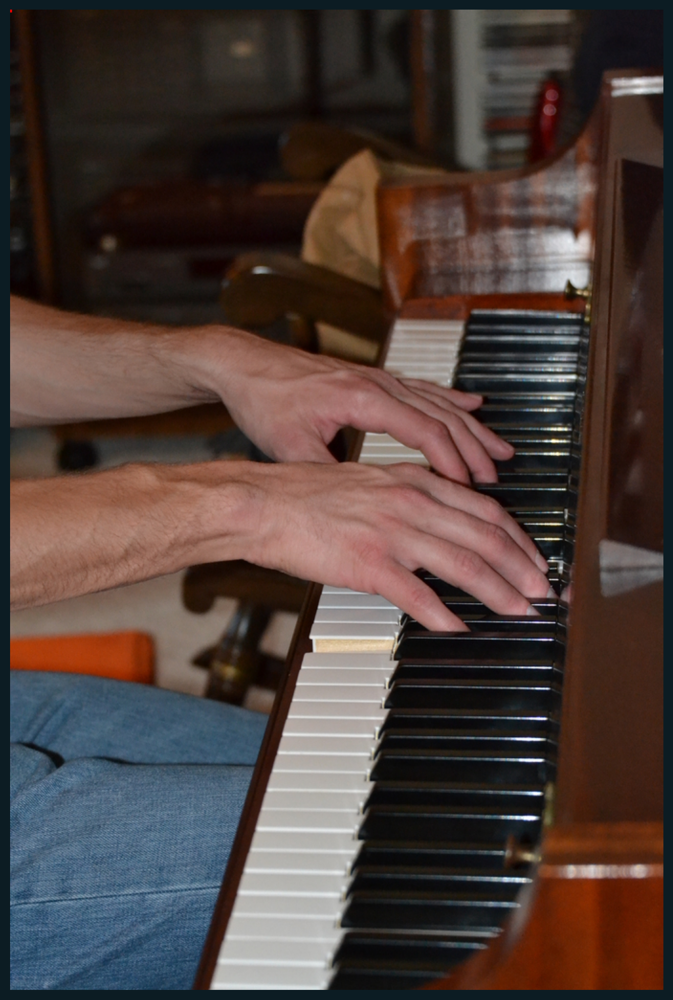

Image: data/open_images/validation/acd8371d50566145.jpg
Scores: [[9.6348643e-01 1.5459809e-02 2.1053741e-02]
 [9.7431087e-01 8.1219478e-03 1.7567249e-02]
 [9.6258038e-01 1.0785185e-02 2.6634365e-02]
 ...
 [9.9859494e-01 3.6203337e-04 1.0430987e-03]
 [9.9802208e-01 9.0710667e-04 1.0709214e-03]
 [9.9571025e-01 4.8147675e-04 3.8082716e-03]]
Boxes: [[-0.05568852 -0.04785236  0.1227518   0.12111288]
 [-0.09539168 -0.09715404  0.17565958  0.1711372 ]
 [-0.06460807 -0.02632631  0.16083732  0.08225951]
 ...
 [ 0.17168254  0.07093015  0.83663934  0.76930344]
 [ 0.19488639  0.16748354  0.9073265   0.8398886 ]
 [ 0.17736015  0.18118337  0.8647429   0.8394048 ]]



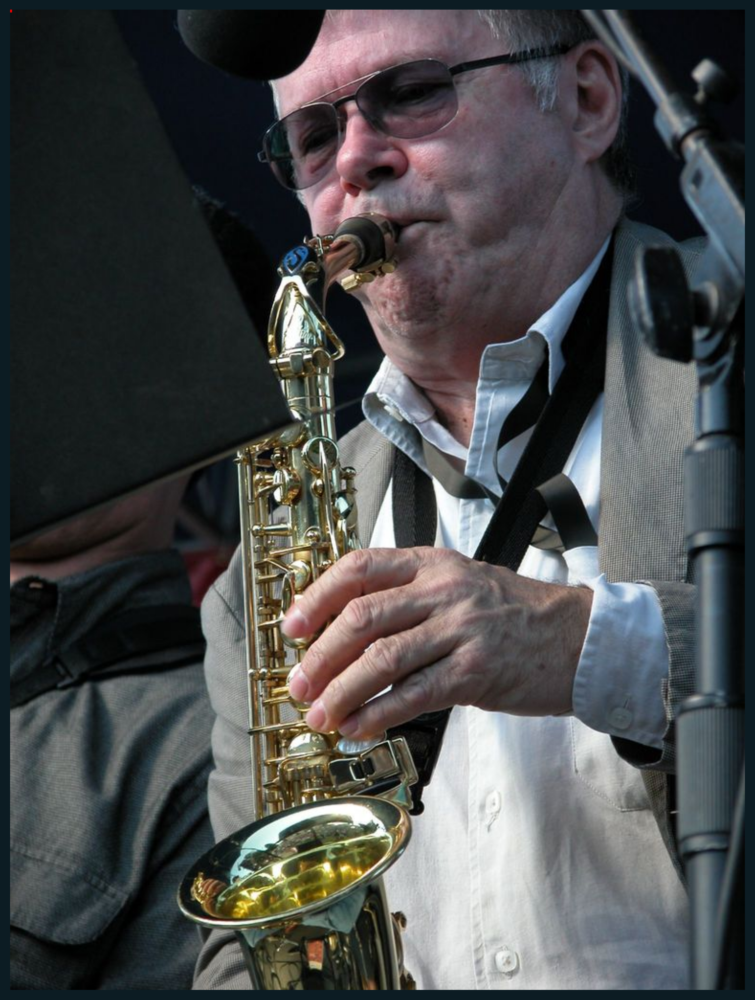

Image: data/open_images/validation/23738324f95fcdca.jpg
Scores: [[9.3440169e-01 1.6686797e-02 4.8911471e-02]
 [9.5712894e-01 6.6908337e-03 3.6180209e-02]
 [9.4127744e-01 5.5849422e-03 5.3137638e-02]
 ...
 [9.9947208e-01 1.5502403e-04 3.7291681e-04]
 [9.9810672e-01 9.4927294e-04 9.4398536e-04]
 [9.9851602e-01 2.6213174e-04 1.2218105e-03]]
Boxes: [[-0.05741539 -0.03768627  0.11324941  0.13866812]
 [-0.09687804 -0.09500937  0.15876107  0.16801853]
 [-0.04852366 -0.00825482  0.14499715  0.08563056]
 ...
 [ 0.14811674  0.1342389   0.8310791   0.7450416 ]
 [ 0.18793103  0.17745805  0.87172794  0.83067214]
 [ 0.17028034  0.21431696  0.8726411   0.8030212 ]]



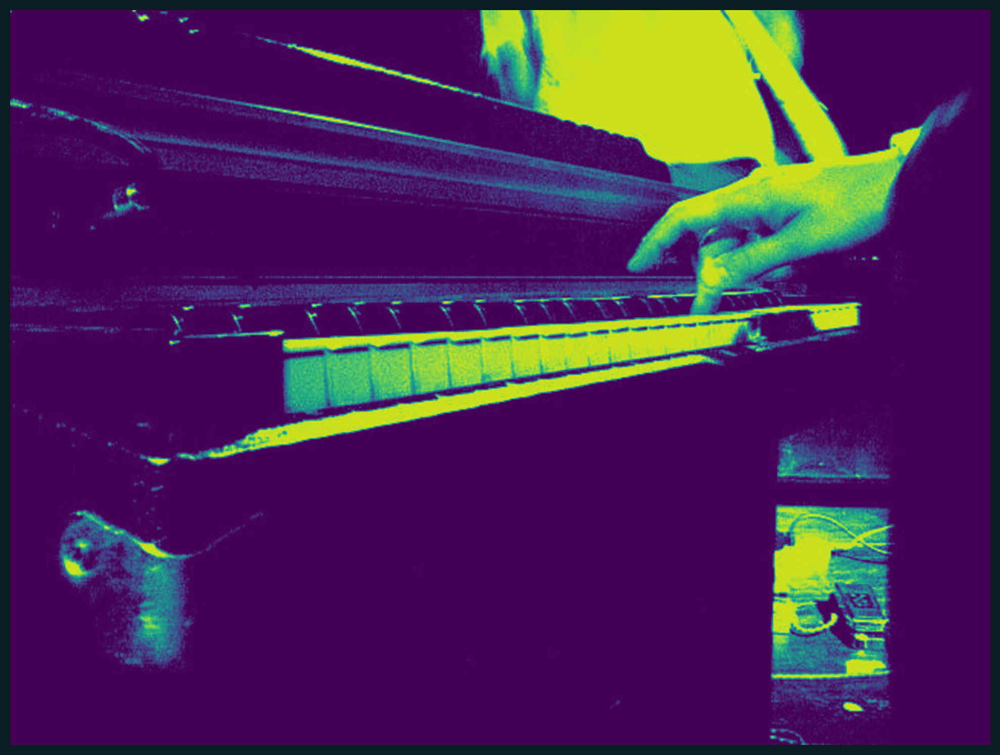

Image: data/open_images/validation/5cab7ef77600e646.jpg
Scores: [[9.6392727e-01 6.5348223e-03 2.9537832e-02]
 [9.7590429e-01 2.1628949e-03 2.1932784e-02]
 [9.5843846e-01 3.7083155e-03 3.7853174e-02]
 ...
 [9.9414295e-01 7.0823892e-04 5.1487898e-03]
 [9.9295253e-01 1.5923620e-03 5.4550678e-03]
 [9.8608935e-01 7.0537976e-04 1.3205246e-02]]
Boxes: [[-0.05775964 -0.04167724  0.11861669  0.11687455]
 [-0.10204879 -0.09121537  0.18457875  0.17975593]
 [-0.05844901 -0.01839011  0.15159148  0.08568387]
 ...
 [ 0.0818066   0.08009067  0.8561022   0.81226754]
 [ 0.12376073  0.11680374  0.876299    0.85755646]
 [ 0.09634316  0.16454294  0.888328    0.85209966]]



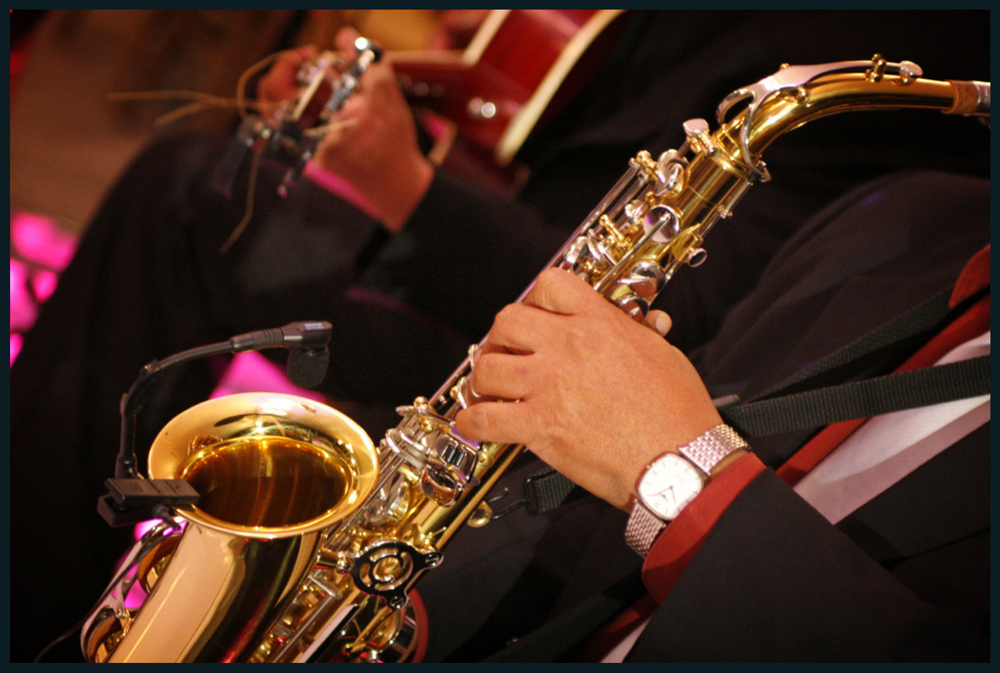

Image: data/open_images/validation/17bc61064b236660.jpg
Scores: [[0.9627348  0.00896426 0.02830097]
 [0.98336214 0.00320131 0.01343658]
 [0.93680245 0.0124234  0.05077422]
 ...
 [0.99635553 0.00129411 0.00235042]
 [0.9942887  0.00284966 0.00286168]
 [0.99030346 0.00157947 0.00811714]]
Boxes: [[-0.0511183  -0.03744498  0.12007451  0.12501037]
 [-0.09236028 -0.07986139  0.19074911  0.17421769]
 [-0.0540851  -0.01466428  0.1530649   0.08264837]
 ...
 [ 0.13278466  0.09318465  0.8620431   0.81033224]
 [ 0.16793373  0.15055433  0.90091777  0.86101496]
 [ 0.14032558  0.19266534  0.8854308   0.8656329 ]]



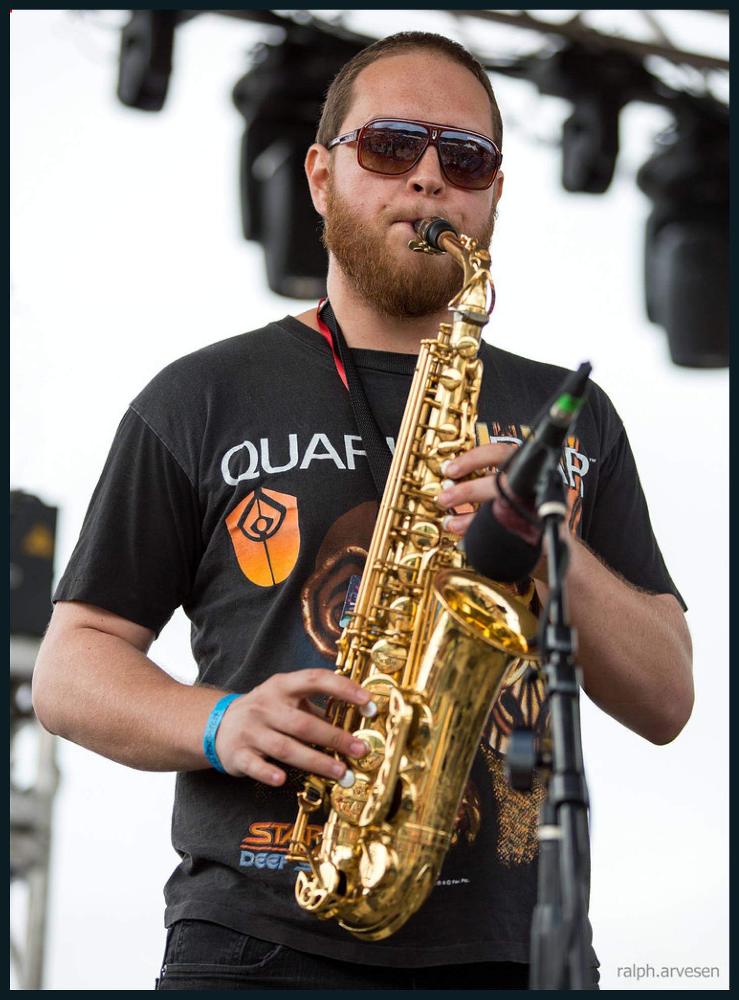

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
ort_session = onnxruntime.InferenceSession(model_path)#, sess_options=sess_options, providers=providers)

# Perform inference using ONNX Runtime
ort_inputs = {ort_session.get_inputs()[0].name: preprocessed_images}
ort_outs = ort_session.run(None, ort_inputs)

# Process the inference results
scores = ort_outs[0]
boxes = ort_outs[1]

# Print the scores and bounding boxes for each image
for i in range(5):
    print(f"Image: {image_paths[i]}")
    print("Scores:", scores[i])
    print("Boxes:", boxes[i])
    print()
    plt.figure(figsize=(10, 10))
    # Load the image using PIL
    image = Image.open(image_paths[i])

    # Create a draw object
    draw = ImageDraw.Draw(image)

    # Iterate over the boxes and scores for the current image
    for score, box in zip(scores[i], boxes[i]):
        # Check if score is a scalar value
        if np.isscalar(score):
            if score > 0.5:
                # Extract the coordinates of the bounding box
                xmin, ymin, xmax, ymax = box

                # Draw the bounding box on the image
                draw.rectangle([(xmin, ymin), (xmax, ymax)], outline='red', width=2)
        else:
            # If score is an array, you can choose to handle it differently
            # For example, you can take the maximum score or average score
            max_score = np.max(score)
            if max_score > 0.5:

                # Extract the coordinates of the bounding box
                xmin, ymin, xmax, ymax = box

                # Draw the bounding box on the image
                draw.rectangle([(xmin, ymin), (xmax, ymax)], outline='red', width=2)
  
            
    # show image draw
     
    # Display the image using matplotlib
    # plt.figure(figsize=(10, 10))
    plt.imshow(np.array(image))
    plt.axis('off')
    plt.show()



Image: /home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/e3c2c93a73de7582.jpg
Scores: [[0.98319477 0.00761779 0.00918739]
 [0.9832508  0.01202126 0.00472805]
 [0.97265583 0.02374384 0.00360032]
 ...
 [0.9029558  0.08297357 0.01407072]
 [0.88481957 0.10352266 0.01165771]
 [0.94719326 0.04366942 0.00913728]]
Boxes: [[-0.04742213 -0.04993899  0.12103935  0.12466216]
 [-0.11116889 -0.0755958   0.16143802  0.16777901]
 [-0.11591063 -0.03231371  0.16489188  0.09362083]
 ...
 [ 0.06713894  0.16928864  0.90570724  0.9225154 ]
 [ 0.07295769  0.08508843  0.9179998   0.96129245]
 [ 0.063227    0.11284879  0.9235856   0.9520924 ]]



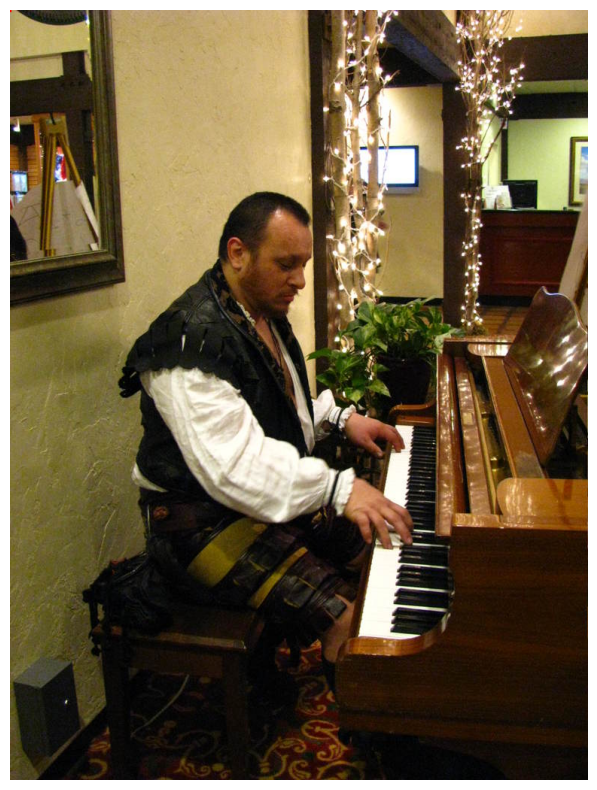

Image: /home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/cf6b3c5f8258a71d.jpg
Scores: [[0.98063356 0.01068527 0.00868116]
 [0.9819547  0.01379727 0.00424804]
 [0.9665972  0.02885771 0.00454516]
 ...
 [0.84472597 0.14187708 0.01339692]
 [0.79871905 0.18795171 0.01332928]
 [0.9216543  0.06905791 0.00928789]]
Boxes: [[-0.05246836 -0.05279653  0.11899574  0.12192118]
 [-0.10912926 -0.07761265  0.16397639  0.16348001]
 [-0.11703661 -0.0380573   0.1570648   0.09379503]
 ...
 [ 0.06163377  0.18236145  0.939709    0.9371042 ]
 [ 0.06666943  0.10182413  0.9329506   0.9563066 ]
 [ 0.05991217  0.10649198  0.9535204   0.9569797 ]]



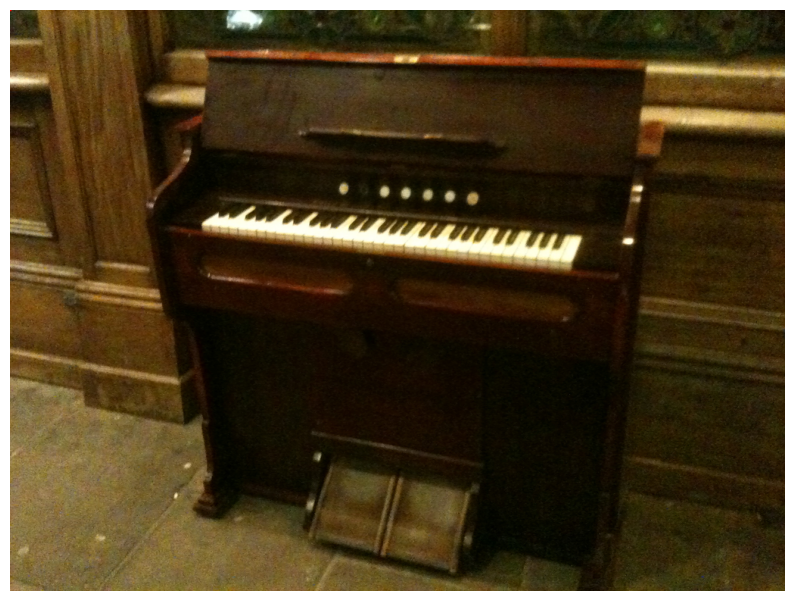

Image: /home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/d9d6b1343c21855a.jpg
Scores: [[0.9776782  0.01412248 0.00819926]
 [0.9863734  0.01030165 0.0033249 ]
 [0.9715919  0.02415341 0.0042546 ]
 ...
 [0.90874964 0.07862613 0.01262424]
 [0.89195    0.09789953 0.01015048]
 [0.9518818  0.0400783  0.00803989]]
Boxes: [[-0.04444463 -0.05217016  0.11374924  0.12462488]
 [-0.09963005 -0.08241704  0.15072262  0.17228475]
 [-0.10304673 -0.0322775   0.15278246  0.09528953]
 ...
 [ 0.06560418  0.17475337  0.9085431   0.92050177]
 [ 0.07562342  0.0789516   0.9159026   0.9696989 ]
 [ 0.0579606   0.11803237  0.9313183   0.9496453 ]]



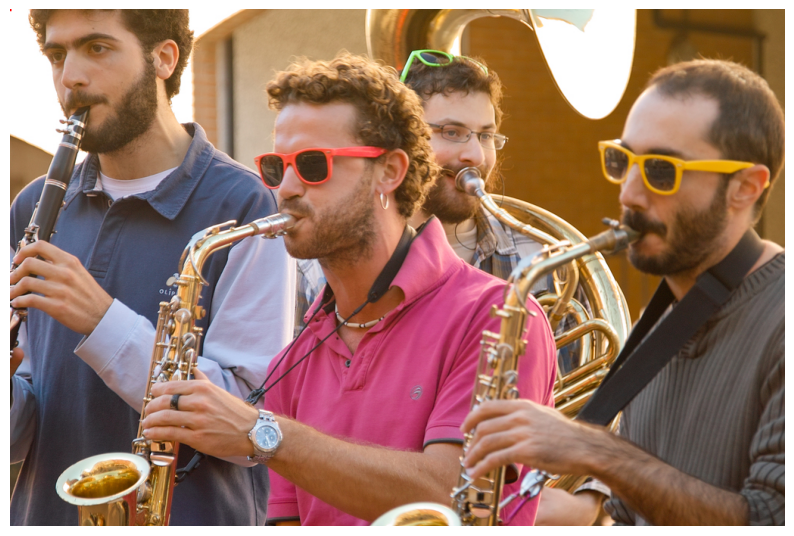

Image: /home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/043506a25417f384.jpg
Scores: [[0.9816751  0.00870048 0.0096245 ]
 [0.97920346 0.01561847 0.00517799]
 [0.9694481  0.02578209 0.00476986]
 ...
 [0.9271984  0.06339307 0.00940853]
 [0.90950614 0.08256259 0.00793129]
 [0.9622217  0.03184304 0.00593531]]
Boxes: [[-0.05589532 -0.05739193  0.10908919  0.13109559]
 [-0.11254972 -0.08702863  0.15974322  0.16952753]
 [-0.11315523 -0.03267543  0.15194078  0.10045138]
 ...
 [ 0.05723554  0.1809906   0.91012216  0.91585743]
 [ 0.07921675  0.06787673  0.9093473   0.98004675]
 [ 0.04450482  0.12042695  0.9367265   0.94778174]]



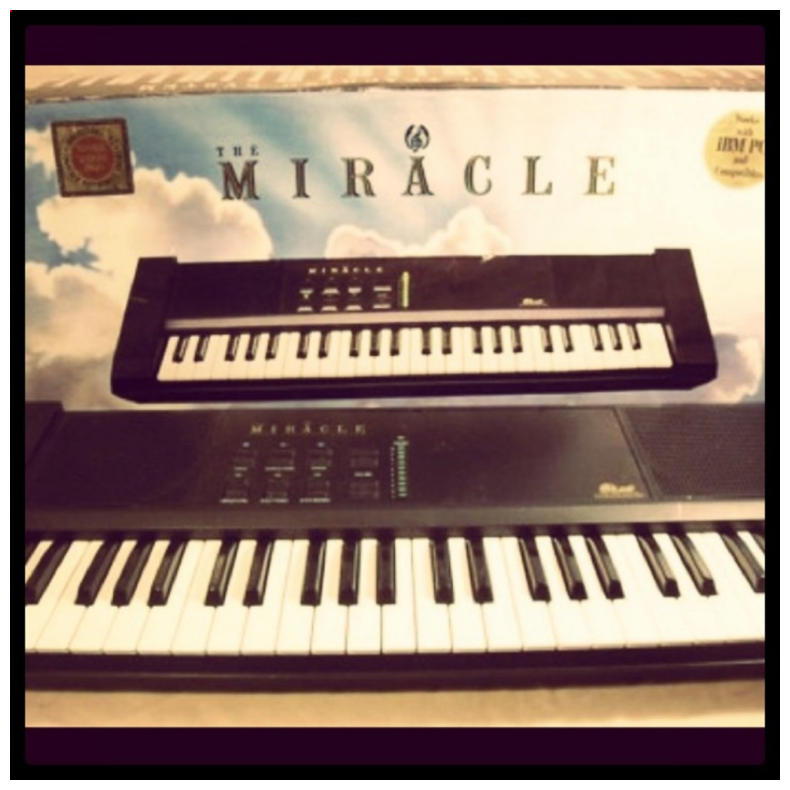

Image: /home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/2e70d5c773dcd171.jpg
Scores: [[0.98002964 0.0111531  0.00881723]
 [0.98698366 0.00968444 0.00333196]
 [0.96792585 0.02640502 0.0056691 ]
 ...
 [0.88634264 0.09508257 0.01857491]
 [0.8706418  0.11462437 0.01473383]
 [0.93632334 0.05132208 0.01235462]]
Boxes: [[-0.05631798 -0.05563644  0.11919749  0.12586987]
 [-0.09829569 -0.07845153  0.1576589   0.16533929]
 [-0.12030438 -0.03389077  0.1514219   0.09197529]
 ...
 [ 0.07588071  0.16229755  0.90151083  0.9259327 ]
 [ 0.07025272  0.09466359  0.9226622   0.9514011 ]
 [ 0.07709941  0.1102978   0.91550624  0.9533955 ]]



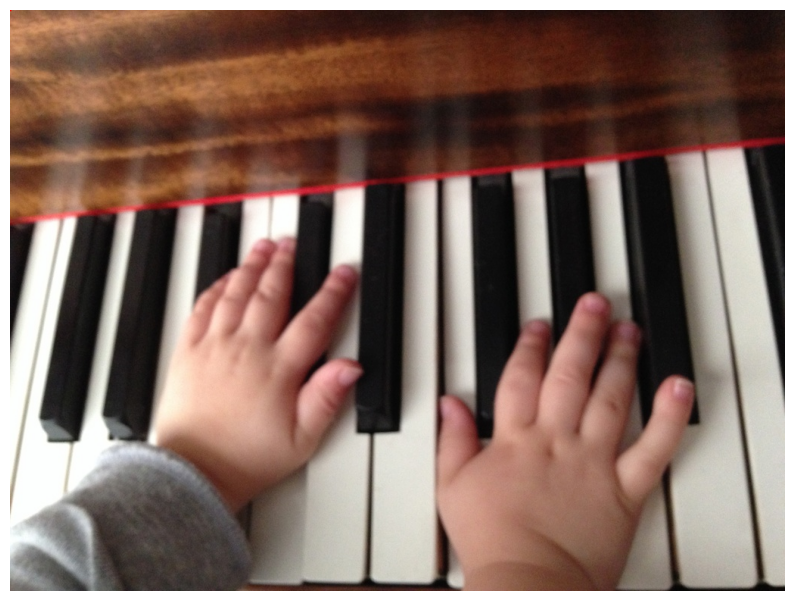

In [129]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw

# Perform inference using ONNX Runtime
ort_inputs = {ort_session.get_inputs()[0].name: preprocessed_images}
ort_outs = ort_session.run(None, ort_inputs)

# Process the inference results
scores = ort_outs[0]
boxes = ort_outs[1]

# Print the scores and bounding boxes for each image
for i in range(5):
    print(f"Image: {image_paths[i]}")
    print("Scores:", scores[i])
    print("Boxes:", boxes[i])
    print()
    plt.figure(figsize=(10, 10))
    # Load the image using PIL
    image = Image.open(image_paths[i])

    # Create a draw object
    draw = ImageDraw.Draw(image)

    # Iterate over the boxes and scores for the current image
    for score, box in zip(scores[i], boxes[i]):
        # Check if score is a scalar value
        if np.isscalar(score):
            if score > 0.5:
                # Extract the coordinates of the bounding box
                xmin, ymin, xmax, ymax = box

                # Draw the bounding box on the image
                draw.rectangle([(xmin, ymin), (xmax, ymax)], outline='red', width=2)
        else:
            # If score is an array, you can choose to handle it differently
            # For example, you can take the maximum score or average score
            max_score = np.max(score)
            if max_score > 0.5:

                # Extract the coordinates of the bounding box
                xmin, ymin, xmax, ymax = box

                # Draw the bounding box on the image
                draw.rectangle([(xmin, ymin), (xmax, ymax)], outline='red', width=2)
  
            
    # show image draw
     
    # Display the image using matplotlib
    # plt.figure(figsize=(10, 10))
    plt.imshow(np.array(image))
    plt.axis('off')
    plt.show()



In [106]:
from PIL import Image
import torchvision.transforms as transforms

img = Image.open(image_paths[0])
resize = transforms.Resize([300, 300])  # Resize to (300, 300)
img = resize(img)

img_rgb = img.convert('RGB')  # Convert to RGB color space
img_y, img_cb, img_cr = img_rgb.split()
to_tensor = transforms.ToTensor()
img_tensor = to_tensor(img_rgb)
img_tensor.unsqueeze_(0)  # Add batch dimension

ort_inputs = {ort_session.get_inputs()[0].name: to_numpy(img_tensor)}
ort_outs = ort_session.run(None, ort_inputs)
img_out_y = ort_outs[0]

img_out_y = Image.fromarray(np.uint8((img_out_y[0] * 255.0).clip(0, 255)[0]), mode='L')

# Resize the Cb and Cr channels to match the size of the output Y channel
img_cb_resized = img_cb.resize(img_out_y.size, Image.BICUBIC)
img_cr_resized = img_cr.resize(img_out_y.size, Image.BICUBIC)

# Get the final output image by merging the Y, Cb, and Cr channels
final_img = Image.merge(
    "YCbCr", [
        img_out_y,
        img_cb_resized,
        img_cr_resized
    ]).convert("RGB")

# Display the final image
display(final_img)



array([[[0.97943693, 0.01312635, 0.00743672],
        [0.97924507, 0.01677407, 0.00398086],
        [0.9585886 , 0.0360679 , 0.00534346],
        ...,
        [0.8352439 , 0.12050126, 0.04425484],
        [0.84927493, 0.12053602, 0.03018899],
        [0.8870436 , 0.07615431, 0.03680213]]], dtype=float32)

In [108]:
from PIL import Image
import torchvision.transforms as transforms

img = Image.open(image_paths[0])
resize = transforms.Resize([300, 300])  # Resize to (300, 300)
img = resize(img)

img_ycbcr = img.convert('YCbCr')  # Convert to YCbCr color space
img_y, img_cb, img_cr = img_ycbcr.split()

to_tensor = transforms.ToTensor()
img_y_tensor = to_tensor(img_y)
img_y_tensor.unsqueeze_(0)  # Add batch dimension

ort_inputs = {ort_session.get_inputs()[0].name: to_numpy(img_y_tensor)}
ort_outs = ort_session.run(None, ort_inputs)
img_out_y = ort_outs[0]

img_out_y = Image.fromarray(np.uint8((img_out_y[0] * 255.0).clip(0, 255)[0]), mode='L')

# Resize the Cb and Cr channels to match the size of the output Y channel
img_cb_resized = img_cb.resize(img_out_y.size, Image.BICUBIC)
img_cr_resized = img_cr.resize(img_out_y.size, Image.BICUBIC)

# Get the final output image by merging the Y, Cb, and Cr channels
final_img = Image.merge(
    "YCbCr", [
        img_out_y,
        img_cb_resized,
        img_cr_resized
    ]).convert("RGB")

# Display the final image
display(final_img)


InvalidArgument: [ONNXRuntimeError] : 2 : INVALID_ARGUMENT : Got invalid dimensions for input: input for the following indices
 index: 1 Got: 1 Expected: 3
 Please fix either the inputs/outputs or the model.

In [93]:
from PIL import Image
import torchvision.transforms as transforms

img = Image.open(image_paths[0])
resize = transforms.Resize([300, 3])
img = resize(img)

img_ycbcr = img.convert('YCbCr')
img_y, img_cb, img_cr = img_ycbcr.split()

to_tensor = transforms.ToTensor()
img_y = to_tensor(img_y)
img_y.unsqueeze_(0)

ort_inputs = {ort_session.get_inputs()[0].name: to_numpy(img_y)}
ort_outs = ort_session.run(None, ort_inputs)
img_out_y = ort_outs[0]


InvalidArgument: [ONNXRuntimeError] : 2 : INVALID_ARGUMENT : Got invalid dimensions for input: input for the following indices
 index: 1 Got: 1 Expected: 3
 index: 3 Got: 3 Expected: 300
 Please fix either the inputs/outputs or the model.

In [43]:
from PIL import Image
import numpy as np
import onnxruntime as ort

# Load and preprocess the image
def preprocess_image(image_path):
    target_size = (300, 300)
    with Image.open(image_path) as image:
        resized_image = image.resize(target_size, Image.BILINEAR)
        image_array = np.array(resized_image).transpose(2, 0, 1)
        image_array = image_array.astype(np.float32) / 255.0  # Convert to float32
        mean_array = np.array([0.485, 0.456, 0.406], dtype=np.float32).reshape(3, 1, 1)
        stddev_array = np.array([0.229, 0.224, 0.225], dtype=np.float32).reshape(3, 1, 1)
        normalized_array = (image_array - mean_array) / stddev_array
        return normalized_array.reshape(1, 3, *target_size), resized_image


    return norm_img_data, img


model_path_onnx = '/home/ubuntu/darien/homework06/p5/pytorch-ssd/mb1-ssd-Epoch-0.onnx'


# Load the ONNX model using ONNX Runtime
ort_session = ort.InferenceSession(model_path_onnx)

# Load and preprocess images
image_paths = glob.glob('/home/ubuntu/darien/homework06/p5/pytorch-ssd/data/open_images/validation/*.jpg')
image_paths = image_paths[:5] 

for image_path in image_paths:
    img_y, img = preprocess_image(image_path)

    print(img_y.shape)


(1, 3, 300, 300)
(1, 3, 300, 300)
(1, 3, 300, 300)
(1, 3, 300, 300)
(1, 3, 300, 300)


In [ ]:
    # Inference
    ort_inputs = {ort_session.get_inputs()[0].name: img_y}
    ort_outs = ort_session.run(None, ort_inputs)
    print(ort_outs[0])
    class_id = np.argmax(ort_outs[0], axis=-1)
    number_handguns = (class_id == 1).sum ()
    number_shotguns = (class_id == 2).sum ()

In [ ]:
    ort_outs = ort_session.run(None, ort_inputs)

    # Process the output
    print(ort_outs[0])
    class_id = np.argmax(ort_outs[0], axis=-1)
    number_handguns = (class_id == 1).sum ()
    number_shotguns = (class_id == 2).sum ()
    print(f"Count of handguns: {number_handguns}, Count of shotguns: {number_shotguns}\n")



8. [BONUS] Parse the response message from the ORT and annotate the two images. Show inferencing output (bounding boxes with labels) for the two images. (5)


In [12]:
# Some standard imports
import numpy as np

from torch import nn
import torch.utils.model_zoo as model_zoo
import torch.onnx